### Libraries

In [2]:
import mysql.connector
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy import stats

### Data Import

In [4]:
csv_file_path = "C:\\Users\\saulr\\Desktop\\cc_fraud_data.csv"
df = pd.read_csv(csv_file_path)

df.head()

,index,trans_date_trans_time,cc_num,merchant,category,amt,first_name,last_name,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,151888,23-03-2019 03:06,3.586010e+15,"fraud_Ferry, Lynch and Kautzer",misc_net,1.24,Crystal,Fuller,F,000 Jennifer Mills,...,47.4974,-122.0107,50489,Osteopath,29-02-1984,ff66e2310bf7a2a05e65d6b0a363aa5b,1332471978,47.352172,-121.644080,0
1,1185025,10/5/2020 11:28,4.671730e+15,fraud_Bogisich Inc,grocery_pos,112.57,Kenneth,Edwards,M,3653 Ryan Crossroad,...,40.8618,-85.6067,2304,Retail banker,25-07-1955,f1edcfa2102065f5f76375c2d20b9081,1368185292,40.265726,-85.914050,0
2,10818,7/1/2019 13:31,3.779930e+14,fraud_Mohr-Bayer,shopping_net,6.69,Nathan,Martinez,M,586 Thomas Cliffs,...,44.8755,-88.1555,5548,Mining engineer,11/9/1975,0caa0ca338d1d2903b92bb42d8905768,1325943086,44.512954,-88.693464,0
3,975275,30-01-2020 18:49,4.710830e+18,fraud_Langworth LLC,personal_care,100.69,Juan,Henry,M,9795 Lori Island Suite 346,...,48.8328,-108.3961,192,Further education lecturer,4/1/1964,c7d25a5388311ebd7f2eef77459376ac,1359571786,47.909634,-109.008657,0
4,346814,12/6/2019 3:04,3.723820e+14,fraud_Hills-Witting,shopping_net,7.80,Brent,Terrell,M,502 Rice Plaza Apt. 979,...,41.8948,-73.9767,2471,Heritage manager,21-01-1966,8e1306b47052ac10fe48512de79edf71,1339470288,41.534838,-74.449927,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 389002 entries, 0 to 389001
Data columns (total 23 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   index                  389002 non-null  int64  
 1   trans_date_trans_time  389002 non-null  object 
 2   cc_num                 389002 non-null  float64
 3   merchant               389002 non-null  object 
 4   category               389002 non-null  object 
 5   amt                    389002 non-null  float64
 6   first_name             389002 non-null  object 
 7   last_name              389002 non-null  object 
 8   gender                 389002 non-null  object 
 9   street                 389002 non-null  object 
 10  city                   389002 non-null  object 
 11  state                  389002 non-null  object 
 12  zip                    389002 non-null  int64  
 13  lat                    389002 non-null  float64
 14  long                   389002 non-nu

## DateTime PreProcessing/Data Cleaning

There are two columns with significant issues with formatting, 'trans_date_trans_time' and 'dob'. There are multiple issues with regards to whether the dates are organized DD-MM-YYYY HH:MM or MM/DD/YYYY HH:MM. The 'dob' column has no time component, which after creating this section required creating a second function to address the lack of time component. 

I started by confirming that the entire dataset (nearly 400,000 data points) was present for the 'trans_date_trans_time' and I evaluated the formatting. After trying multiple methods to uniformly format the datetime data, I figured it would be easier to have Python only identify the datetime values that were formatted with forward slashes (eg MM/DD/YYYY HH:MM) and ignore the dashed datetime values (eg. DD-MM-YYYY HH:MM). I wrote a function that would inspect and return the modified datetime and ignore (and return) the datetime as requested. After confirming that the function worked, I then wrote code to simply modify the formatting so that the datetime would be in MM-DD-YYYY HH:MM (Dashed and in Month-Day-Year Hour:Minute) format. I then proceeded to rename the column to 'trans_datetime'.

I attempted to run the 'dob' column using the same function that I previously used on the 'trans_date_trans_time' column, however when I inspected the dataframe, no changes were made. Upon additional research, I determined that the function would only work if Hours:Minutes were incorporated, something I failed to notice upon initial inspection. I proceeded to create a new function, removing the Hour:Minute requirement. 

I confirmed that there were no null values or errors.

References: 
1) https://towardsdatascience.com/clean-a-messy-date-column-with-mixed-formats-in-pandas-1a88808edbf7/
2) https://pandas.pydata.org/docs/user_guide/timeseries.html
3) https://docs.python.org/3/library/datetime.html

In [7]:
print(df['trans_date_trans_time'].count())

389002


In [8]:
df['trans_date_trans_time'].head(10)

0    23-03-2019 03:06
1     10/5/2020 11:28
2      7/1/2019 13:31
3    30-01-2020 18:49
4      12/6/2019 3:04
5    13-02-2019 04:09
6    17-06-2019 06:36
7    25-08-2019 21:15
8      6/9/2019 11:27
9    29-04-2019 17:08
Name: trans_date_trans_time, dtype: object

In [9]:
def convert_date_format(date_str):
    try:
        parsed_date = pd.to_datetime(date_str, format='%m/%d/%Y %H:%M', errors='coerce')
        if pd.notna(parsed_date):
            return parsed_date.strftime('%d-%m-%Y %H:%M')

        parsed_date = pd.to_datetime(date_str, format='%d-%m-%Y %H:%M', errors='coerce')
        if pd.notna(parsed_date):
            return parsed_date.strftime('%d-%m-%Y %H:%M')

    except Exception:
        return date_str

In [10]:
df['trans_date_trans_time'] = df['trans_date_trans_time'].astype(str).apply(convert_date_format)

In [11]:
df['trans_date_trans_time'].head(10)

0    23-03-2019 03:06
1    05-10-2020 11:28
2    01-07-2019 13:31
3    30-01-2020 18:49
4    06-12-2019 03:04
5    13-02-2019 04:09
6    17-06-2019 06:36
7    25-08-2019 21:15
8    09-06-2019 11:27
9    29-04-2019 17:08
Name: trans_date_trans_time, dtype: object

In [12]:
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'], format = '%d-%m-%Y %H:%M').dt.strftime('%m-%d-%Y %H:%M')

In [13]:
df['trans_date_trans_time'].head(10)

0    03-23-2019 03:06
1    10-05-2020 11:28
2    07-01-2019 13:31
3    01-30-2020 18:49
4    12-06-2019 03:04
5    02-13-2019 04:09
6    06-17-2019 06:36
7    08-25-2019 21:15
8    06-09-2019 11:27
9    04-29-2019 17:08
Name: trans_date_trans_time, dtype: object

In [14]:
df.rename(columns = {'trans_date_trans_time':'trans_datetime'}, inplace = True)

In [15]:
df.head(10)

,index,trans_datetime,cc_num,merchant,category,amt,first_name,last_name,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,151888,03-23-2019 03:06,3.586010e+15,"fraud_Ferry, Lynch and Kautzer",misc_net,1.24,Crystal,Fuller,F,000 Jennifer Mills,...,47.4974,-122.0107,50489,Osteopath,29-02-1984,ff66e2310bf7a2a05e65d6b0a363aa5b,1332471978,47.352172,-121.644080,0
1,1185025,10-05-2020 11:28,4.671730e+15,fraud_Bogisich Inc,grocery_pos,112.57,Kenneth,Edwards,M,3653 Ryan Crossroad,...,40.8618,-85.6067,2304,Retail banker,25-07-1955,f1edcfa2102065f5f76375c2d20b9081,1368185292,40.265726,-85.914050,0
2,10818,07-01-2019 13:31,3.779930e+14,fraud_Mohr-Bayer,shopping_net,6.69,Nathan,Martinez,M,586 Thomas Cliffs,...,44.8755,-88.1555,5548,Mining engineer,11/9/1975,0caa0ca338d1d2903b92bb42d8905768,1325943086,44.512954,-88.693464,0
3,975275,01-30-2020 18:49,4.710830e+18,fraud_Langworth LLC,personal_care,100.69,Juan,Henry,M,9795 Lori Island Suite 346,...,48.8328,-108.3961,192,Further education lecturer,4/1/1964,c7d25a5388311ebd7f2eef77459376ac,1359571786,47.909634,-109.008657,0
4,346814,12-06-2019 03:04,3.723820e+14,fraud_Hills-Witting,shopping_net,7.80,Brent,Terrell,M,502 Rice Plaza Apt. 979,...,41.8948,-73.9767,2471,Heritage manager,21-01-1966,8e1306b47052ac10fe48512de79edf71,1339470288,41.534838,-74.449927,0
5,74446,02-13-2019 04:09,3.529600e+15,"fraud_Eichmann, Bogan and Rodriguez",gas_transport,71.23,Pamela,Curtis,F,8969 Fuentes Station Apt. 291,...,40.4679,-77.8967,1334,Archaeologist,17-12-1986,1c3f7db4310986aaf21176e9d87ca8bc,1329106167,41.248622,-77.511456,0
6,361658,06-17-2019 06:36,4.646850e+18,"fraud_Kerluke, Considine and Macejkovic",misc_net,184.77,Julia,Bell,F,576 House Crossroad,...,40.7320,-73.1000,4056,Film/video editor,25-06-1990,efb9f79d779ded8851b25ec260ed8f04,1339915000,40.995128,-72.156613,0
7,557547,08-25-2019 21:15,6.304690e+11,fraud_Effertz LLC,entertainment,19.04,Meredith,Ayala,F,7107 Henderson Station,...,45.6710,-121.8686,1288,Barrister,1/5/1936,67b42fbbf21b3bc4019efd10d0c17ace,1345929300,45.217483,-122.617723,0
8,586979,06-09-2019 11:27,2.131260e+14,fraud_Cummings LLC,gas_transport,47.66,Adam,Kirk,M,40847 Stark Junctions,...,42.0740,-74.4530,397,Psychiatrist,12/9/1931,72f77b61178ce420fd7db555cbb73450,1346930827,43.019068,-73.876839,0
9,238768,04-29-2019 17:08,3.054110e+13,"fraud_Hettinger, McCullough and Fay",home,49.14,Derrick,George,M,575 Chapman Union,...,30.0377,-95.5326,316665,"Education officer, museum",12/9/1990,2c0f45f576a11e18a60aa3889467e826,1335719325,30.874205,-96.519524,0


In [16]:
df['dob'].count()

389002

In [17]:
df['dob'].head(10)

0    29-02-1984
1    25-07-1955
2     11/9/1975
3      4/1/1964
4    21-01-1966
5    17-12-1986
6    25-06-1990
7      1/5/1936
8     12/9/1931
9     12/9/1990
Name: dob, dtype: object

In [18]:
def convert_date_format_only(date_str):
    try:
        parsed_date = pd.to_datetime(date_str, format='%m/%d/%Y', errors='coerce')
        if pd.notna(parsed_date):                             
            return parsed_date.strftime('%d-%m-%Y')

        parsed_date = pd.to_datetime(date_str, format='%d-%m-%Y', errors='coerce')
        if pd.notna(parsed_date):
            return parsed_date.strftime('%d-%m-%Y')  

    except Exception:
        return date_str

In [19]:
df['dob'] = df['dob'].astype(str).apply(convert_date_format_only)
print(df['dob'].head(10))

0    29-02-1984
1    25-07-1955
2    09-11-1975
3    01-04-1964
4    21-01-1966
5    17-12-1986
6    25-06-1990
7    05-01-1936
8    09-12-1931
9    09-12-1990
Name: dob, dtype: object


In [20]:
df['dob'] = pd.to_datetime(df['dob'], format = '%d-%m-%Y').dt.strftime('%m-%d-%Y')
print(df['dob'].head(10))

0    02-29-1984
1    07-25-1955
2    11-09-1975
3    04-01-1964
4    01-21-1966
5    12-17-1986
6    06-25-1990
7    01-05-1936
8    12-09-1931
9    12-09-1990
Name: dob, dtype: object


In [21]:
df['trans_datetime'].isnull().sum()

0

In [22]:
df['dob'].isnull().sum()

0

In [23]:
df.head()

,index,trans_datetime,cc_num,merchant,category,amt,first_name,last_name,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,151888,03-23-2019 03:06,3.586010e+15,"fraud_Ferry, Lynch and Kautzer",misc_net,1.24,Crystal,Fuller,F,000 Jennifer Mills,...,47.4974,-122.0107,50489,Osteopath,02-29-1984,ff66e2310bf7a2a05e65d6b0a363aa5b,1332471978,47.352172,-121.644080,0
1,1185025,10-05-2020 11:28,4.671730e+15,fraud_Bogisich Inc,grocery_pos,112.57,Kenneth,Edwards,M,3653 Ryan Crossroad,...,40.8618,-85.6067,2304,Retail banker,07-25-1955,f1edcfa2102065f5f76375c2d20b9081,1368185292,40.265726,-85.914050,0
2,10818,07-01-2019 13:31,3.779930e+14,fraud_Mohr-Bayer,shopping_net,6.69,Nathan,Martinez,M,586 Thomas Cliffs,...,44.8755,-88.1555,5548,Mining engineer,11-09-1975,0caa0ca338d1d2903b92bb42d8905768,1325943086,44.512954,-88.693464,0
3,975275,01-30-2020 18:49,4.710830e+18,fraud_Langworth LLC,personal_care,100.69,Juan,Henry,M,9795 Lori Island Suite 346,...,48.8328,-108.3961,192,Further education lecturer,04-01-1964,c7d25a5388311ebd7f2eef77459376ac,1359571786,47.909634,-109.008657,0
4,346814,12-06-2019 03:04,3.723820e+14,fraud_Hills-Witting,shopping_net,7.80,Brent,Terrell,M,502 Rice Plaza Apt. 979,...,41.8948,-73.9767,2471,Heritage manager,01-21-1966,8e1306b47052ac10fe48512de79edf71,1339470288,41.534838,-74.449927,0


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 389002 entries, 0 to 389001
Data columns (total 23 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   index           389002 non-null  int64  
 1   trans_datetime  389002 non-null  object 
 2   cc_num          389002 non-null  float64
 3   merchant        389002 non-null  object 
 4   category        389002 non-null  object 
 5   amt             389002 non-null  float64
 6   first_name      389002 non-null  object 
 7   last_name       389002 non-null  object 
 8   gender          389002 non-null  object 
 9   street          389002 non-null  object 
 10  city            389002 non-null  object 
 11  state           389002 non-null  object 
 12  zip             389002 non-null  int64  
 13  lat             389002 non-null  float64
 14  long            389002 non-null  float64
 15  city_pop        389002 non-null  int64  
 16  job             389002 non-null  object 
 17  dob       

## Creating a Connection Between Jupyter Notebook and MySQL Workbench

The raw dataset, nearing 100MB, posed a significant challenge for direct import into MySQL Workbench using the table import wizard, which was **prohibitively** slow. To address this, I explored an alternative approach by creating a connection between Jupyter Notebook and MySQL, a process that required extensive research and trial-and-error, as I had no prior instruction on this method.

The initial hurdle was establishing a successful connection and inserting data into a `transactions` table. My first attempt involved row-by-row insertion, which proved excessively time-consuming. Further investigation revealed that batch processing—sending data in manageable chunks—could significantly improve efficiency. Determining an optimal batch size was challenging, so I implemented code to print success and failure messages for each batch. This approach, while informative, overwhelmed the terminal and eventually failed. 

By modifying the code to print only batch errors, I achieved a successful import in under a minute, demonstrating the power of batch processing for large datasets.

In [26]:
df['trans_datetime'] = pd.to_datetime(df['trans_datetime'], format='%m-%d-%Y %H:%M')
df['dob'] = pd.to_datetime(df['dob'], format='%m-%d-%Y').dt.date

connection = mysql.connector.connect(
    host='127.0.0.1',
    user='root',
    password='Washington1776!',
    database='finance_alpha'
)

if connection.is_connected():
    print('Connection Established')

cursor = connection.cursor()

sql = """
INSERT INTO transactions (
    `index`, trans_datetime, cc_num, merchant, category, amt,
    first_name, last_name, gender, street, city, state, zip, lat,
    `long`, city_pop, job, dob, trans_num, unix_time,
    merch_lat, merch_long, is_fraud
) VALUES (
    %s, %s, %s, %s, %s, %s,
    %s, %s, %s, %s, %s, %s, %s, %s,
    %s, %s, %s, %s, %s, %s,
    %s, %s, %s
)
"""
batch_size = 10000
error_batches = []

for i in range(0, len(df), batch_size):
    batch = df.iloc[i:i + batch_size]
    data = [tuple(row) for row in batch.itertuples(index=False)]

    connection.ping(reconnect=True)
    try:
        cursor.executemany(sql, data)
        connection.commit()
    except mysql.connector.Error as err:
        error_batches.append((i, i + batch_size))
        print(f"Error in batch {i} to {i + batch_size}: {err}")

cursor.close()
connection.close()

if error_batches:
    print(f" Batches Failed: {error_batches}")
else:
    print('Upload Successful')

Connection Established
Error in batch 0 to 10000: 1062 (23000): Duplicate entry '151888' for key 'transactions.PRIMARY'
Error in batch 10000 to 20000: 1062 (23000): Duplicate entry '882244' for key 'transactions.PRIMARY'
Error in batch 20000 to 30000: 1062 (23000): Duplicate entry '395060' for key 'transactions.PRIMARY'
Error in batch 30000 to 40000: 1062 (23000): Duplicate entry '788341' for key 'transactions.PRIMARY'
Error in batch 40000 to 50000: 1062 (23000): Duplicate entry '100528' for key 'transactions.PRIMARY'
Error in batch 50000 to 60000: 1062 (23000): Duplicate entry '788784' for key 'transactions.PRIMARY'
Error in batch 60000 to 70000: 1062 (23000): Duplicate entry '207647' for key 'transactions.PRIMARY'
Error in batch 70000 to 80000: 1062 (23000): Duplicate entry '951742' for key 'transactions.PRIMARY'
Error in batch 80000 to 90000: 1062 (23000): Duplicate entry '417155' for key 'transactions.PRIMARY'
Error in batch 90000 to 100000: 1062 (23000): Duplicate entry '711532' f

**Checking Values using .loc on 'index' to confirm ETL process successful** 

In [28]:
df.loc[df['index'] == 11]

,index,trans_datetime,cc_num,merchant,category,amt,first_name,last_name,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
65171,11,2019-01-01 00:06:00,3.772340e+14,fraud_Kerluke-Abshire,shopping_net,7.77,Theresa,Blackwell,F,43576 Kristina Islands,...,39.3716,-77.8229,1925,Systems developer,1966-02-14,3c74776e558f1499a7824b556e474b1d,1325376413,40.103866,-78.624459,0


In [29]:
df.loc[11]

index                                          1078308
trans_datetime                     2020-03-23 21:04:00
cc_num                                 4862290000000.0
merchant          fraud_Medhurst, Cartwright and Ebert
category                                 personal_care
amt                                              34.15
first_name                                   Elizabeth
last_name                                        Payne
gender                                               F
street                           897 Daugherty Mission
city                                         Grassflat
state                                               PA
zip                                              16839
lat                                            41.0036
long                                          -78.1104
city_pop                                           489
job                             Pension scheme manager
dob                                         1956-09-15
trans_num 

## Python Tasks
*Exploratory Data Analysis with Python*

**Understanding the Dataset Size:**
To begin, I checked the dimensions of the dataset to confirm its size and structure. Knowing the number of transactions and features will help assess whether the data is sufficient for fraud detection analysis. 

In [32]:
rows, columns = df.shape
print(f'The dataframe has the following dimensions: {rows} rows and {columns} columns.')

The dataframe has the following dimensions: 389002 rows and 23 columns.


In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 389002 entries, 0 to 389001
Data columns (total 23 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   index           389002 non-null  int64         
 1   trans_datetime  389002 non-null  datetime64[ns]
 2   cc_num          389002 non-null  float64       
 3   merchant        389002 non-null  object        
 4   category        389002 non-null  object        
 5   amt             389002 non-null  float64       
 6   first_name      389002 non-null  object        
 7   last_name       389002 non-null  object        
 8   gender          389002 non-null  object        
 9   street          389002 non-null  object        
 10  city            389002 non-null  object        
 11  state           389002 non-null  object        
 12  zip             389002 non-null  int64         
 13  lat             389002 non-null  float64       
 14  long            389002 non-null  flo

**Exploring Categorical Data:** The goal of exploring the categorical data is to determine if patterns exist. By counting the unique values of each variable, there is room to determine if a variable(s) requires additional attention. 

For example, there is no need to explore the distinct count for the date of birth as the number of distinct birthdays in this dataset is not immediately indicative of fraudulent activity. However, further exploration may require analysis of date of birth.

In [35]:
df_unique = df.select_dtypes(include = ['object', 'int64']).nunique().to_frame().reset_index()
df_unique.columns = ['Type', 'Distinct Count']
print('Number of Unique Values in for each Categorical Variable:')
print(df_unique)

# Reference: 
# 1) https://stackoverflow.com/questions/59951043/to-extract-distinct-values-for-all-categorical-columns-in-dataframe
# 2) https://www.w3schools.com/python/pandas/ref_df_select_dtypes.asp

Number of Unique Values in for each Categorical Variable:
          Type  Distinct Count
0        index          389002
1     merchant             693
2     category              14
3   first_name             352
4    last_name             481
5       gender               2
6       street             979
7         city             890
8        state              51
9          zip             966
10    city_pop             875
11         job             492
12         dob             964
13   trans_num          389002
14   unix_time          387019
15    is_fraud               2


**Visualization of Distribution**

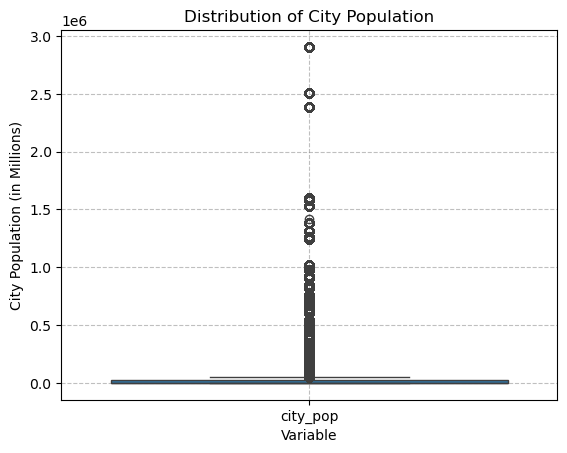

In [44]:
sns.boxplot(data = df[['city_pop']])
plt.title('Distribution of City Population')
plt.xlabel('Variable')
plt.ylabel('City Population (in Millions)')
plt.grid(color = 'gray', linestyle = '--', alpha = 0.5)

plt.savefig('city_population_distribution.png', format = 'png')
plt.show()

In [46]:
print('Number of Null Values: ')
df.isna().sum()

Number of Null Values: 


index             0
trans_datetime    0
cc_num            0
merchant          0
category          0
amt               0
first_name        0
last_name         0
gender            0
street            0
city              0
state             0
zip               0
lat               0
long              0
city_pop          0
job               0
dob               0
trans_num         0
unix_time         0
merch_lat         0
merch_long        0
is_fraud          0
dtype: int64

In [47]:
df[['amt','city_pop']].describe()

,amt,city_pop
count,389002.000000,3.890020e+05
mean,70.442148,8.868084e+04
std,162.203915,3.012101e+05
min,1.000000,2.300000e+01
25%,9.660000,7.430000e+02
50%,47.570000,2.456000e+03
75%,83.077500,2.032800e+04
max,27390.120000,2.906700e+06


In [48]:
df[['amt','city_pop']].corr()

,amt,city_pop
amt,1.000000,0.007271
city_pop,0.007271,1.000000


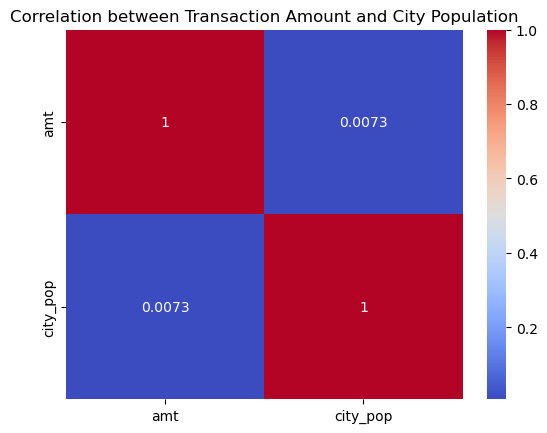

In [57]:
sns.heatmap(df[['amt','city_pop']].corr(), annot = True, cmap = 'coolwarm')
plt.title('Correlation between Transaction Amount and City Population')

plt.savefig('transaction_population_correlation_matrix.png', format = 'png')
plt.show()

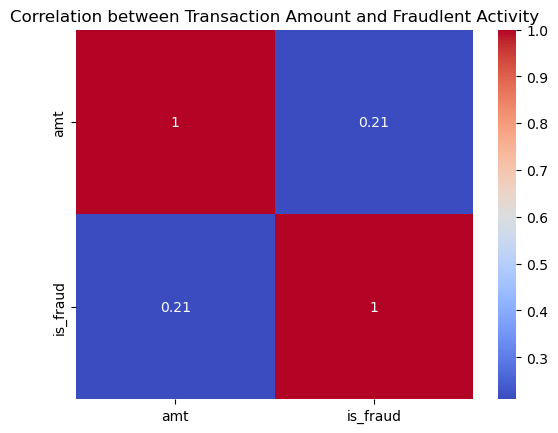

In [58]:
sns.heatmap(df[['amt', 'is_fraud']].corr(), annot = True, cmap = 'coolwarm')
plt.title('Correlation between Transaction Amount and Fraudlent Activity')

plt.savefig('transaction_amount_isfraud_correlation_matrix.png', format = 'png')
plt.show()

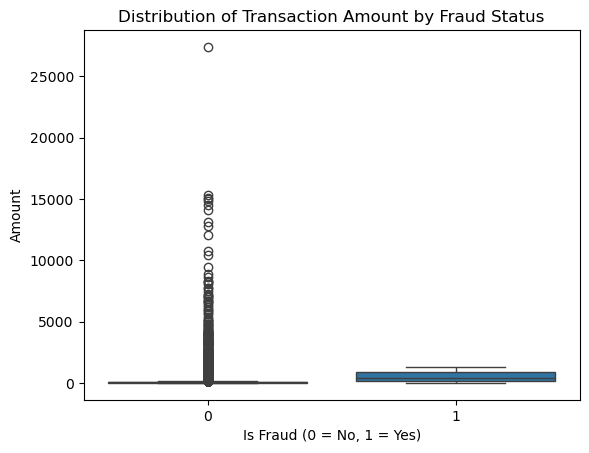

<Figure size 1000x600 with 0 Axes>

In [59]:
sns.boxplot(x = 'is_fraud', y = 'amt', data = df)
plt.title('Distribution of Transaction Amount by Fraud Status')
plt.xlabel('Is Fraud (0 = No, 1 = Yes)')
plt.ylabel('Amount')
plt.figure(figsize = (10,6))

plt.savefig('distribution_transaction_fraudulentact.png', format = 'png')
plt.show()

In [60]:
df.describe()

,index,trans_datetime,cc_num,amt,zip,lat,long,city_pop,unix_time,merch_lat,merch_long,is_fraud
count,3.890020e+05,389002,3.890020e+05,389002.000000,389002.000000,389002.000000,389002.000000,3.890020e+05,3.890020e+05,389002.000000,389002.000000,389002.000000
mean,6.485205e+05,2019-10-07 19:14:16.994257408,4.191513e+17,70.442148,48818.064295,38.533121,-90.237664,8.868084e+04,1.349251e+09,38.531683,-90.236674,0.005789
min,1.100000e+01,2019-01-01 00:06:00,6.041621e+10,1.000000,1257.000000,20.027100,-165.672300,2.300000e+01,1.325376e+09,19.029798,-166.669638,0.000000
25%,3.241842e+05,2019-05-25 14:48:30,1.800430e+14,9.660000,26237.000000,34.620500,-96.798000,7.430000e+02,1.338751e+09,34.719394,-96.905445,0.000000
50%,6.486485e+05,2019-09-23 15:18:00,3.521420e+15,47.570000,48174.000000,39.354300,-87.476900,2.456000e+03,1.349267e+09,39.361065,-87.446843,0.000000
75%,9.735032e+05,2020-02-02 20:31:00,4.642260e+15,83.077500,72011.000000,41.940400,-80.158000,2.032800e+04,1.359460e+09,41.956012,-80.253831,0.000000
max,1.296674e+06,2020-12-06 23:58:00,4.992350e+18,27390.120000,99783.000000,66.693300,-67.950300,2.906700e+06,1.371817e+09,67.064277,-66.956540,1.000000
std,3.745744e+05,NaN,1.311579e+18,162.203915,26879.383224,5.074596,13.745855,3.012101e+05,1.285085e+07,5.109400,13.757311,0.075866


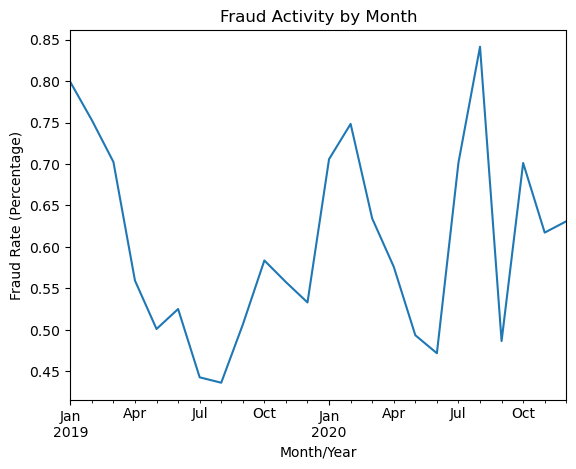

<Figure size 1000x600 with 0 Axes>

In [61]:
df['trans_monthly'] = df['trans_datetime'].dt.to_period('M')
fraud_trends = df.groupby('trans_monthly')['is_fraud'].mean() * 100
fraud_trends.plot()
plt.title('Fraud Activity by Month')
plt.xlabel('Month/Year')
plt.ylabel('Fraud Rate (Percentage)')
plt.figure(figsize = (10,6))

plt.savefig('fraud_activity_monthly.png', format = 'png')
plt.show()

In [62]:
print('Fraud Distribution by Category')
fraud_by_category = df.groupby('category')['is_fraud'].mean().round(5).sort_values(ascending = False) * 100
print(fraud_by_category)

Fraud Distribution by Category
category
shopping_net      1.632
misc_net          1.502
grocery_pos       1.409
shopping_pos      0.723
gas_transport     0.487
travel            0.344
misc_pos          0.320
grocery_net       0.289
personal_care     0.278
entertainment     0.242
kids_pets         0.218
home              0.176
food_dining       0.155
health_fitness    0.152
Name: is_fraud, dtype: float64


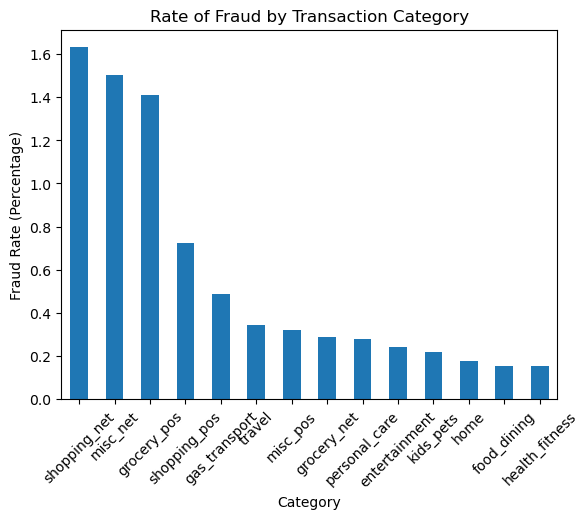

<Figure size 1000x600 with 0 Axes>

In [63]:
fraud_by_category.plot(kind = 'bar')
plt.title('Rate of Fraud by Transaction Category')
plt.xlabel('Category')
plt.ylabel('Fraud Rate (Percentage)')
plt.xticks(rotation = 45)
plt.figure(figsize = (10,6))

plt.savefig('rate_fraud_by_category.png', format = 'png')
plt.show()

In [64]:
##Unusual Values

In [65]:
df[['amt', 'city_pop']].min()

amt          1.0
city_pop    23.0
dtype: float64

In [66]:
df[df['trans_num'].duplicated()]

,index,trans_datetime,cc_num,merchant,category,amt,first_name,last_name,gender,street,...,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud,trans_monthly


In [67]:
fig1 = px.violin(df, x = 'gender', y = 'amt', color = 'is_fraud', box = True, title = 'Interactive Violin Plot of Transaction Amount by Gender and Fraud Status')
fig1.update_layout(xaxis_title = 'Gender', yaxis_title = 'Transaction Amount')

fig1.write_image('transaction_by_gender_and_fraud_violin.png', format = 'png')
fig1.write_html('transaction_by_gender_and_fraud_violin.html')
fig1.show()

## Creating CSV to Upload to Tableau Public

In [69]:
print(df['trans_datetime'].dtype)

datetime64[ns]


In [70]:
print(df['dob'].dtype)

object


In [71]:
df['dob'] = pd.to_datetime(df['dob'], errors='coerce')
print(df['dob'].dtype)

datetime64[ns]


In [72]:
df.to_csv('transactions_capstone.csv', index = False)